In [1]:
import h5py
import httpx
import matplotlib.pyplot as plt
import numpy as np
import obspy
import matplotlib.pyplot as plt
from obspy import UTCDateTime

In [2]:
long=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/1long.mseed")
short=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/1short.mseed")
prediction=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/YL.A01.2010-02-07T23:00:00.000000Z.2010-02-08T00:00:00.000000Z.prediction.mseed")
waveform=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/YL.A01.2010-02-07T23:00:00.000000Z.2010-02-08T00:00:00.000000Z.waveform.mseed")


In [3]:
vec_long=np.zeros((3,144001))
for i in range(3):
    vec_long[i,:]=long[i].data[:144001]

vec_short=np.zeros((3,4801))
for i in range(3):
    vec_short[i,:]=short[i].data[:4801]

In [4]:
id=["short.A01","long.A01"]
timestamp=["2010-02-07T23:24:06.949590","2010-02-07T23"]
vec=[vec_short.tolist(),vec_long.tolist()]
extract_phases=["P","S"]
extract_phase_sensitivity=[0.5,0.5]
# id=["long.A01"]
# timestamp=["2010-02-07T23"]
# vec=[vec_long.tolist()]
# extract_phases=["P","S"]
# extract_phase_sensitivity=[0.5,0.5]

headers = {
    'Content-Type': 'application/json'
}

request_body={
    "id":id,
    "timestamp":timestamp,
    "vec":vec,
    "extract_phases":extract_phases,
    "extract_phase_sensitivity":extract_phase_sensitivity
}

In [5]:
url = "http://0.0.0.0:8080/predict"
response = httpx.post(url, headers=headers, json=request_body,timeout=600)

# Check if the request was successful (HTTP status code 200)
if response.status_code == 200:
    print("Request was successful!")
    print("Response:", response.json())
else:
    print("Request failed with status code:", response.status_code)

Request was successful!
Response: {'id': ['short.A01', 'long.A01'], 'possibility': [{'noise': [0.9999773502349854, 0.9999898672103882, 0.9999955892562866, 0.9999979734420776, 0.9999991655349731, 0.9999991655349731, 0.9999994039535522, 0.9999995231628418, 0.9999995231628418, 0.9999995231628418, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999995231628418, 0.9999995231628418, 0.9999995231628418, 0.9999994039535522, 0.9999994039535522, 0.9999992847442627, 0.9999992847442627, 0.9999991655349731, 0.9999990463256836, 0.999998927116394, 0.9999988079071045, 0.9999986886978149, 0.9999984502792358, 0.9999983310699463, 0.9999983310699463, 0.9999980926513672, 0.9999978542327881, 0.999997615814209, 0.9999974966049194, 0.9999973773956299, 0.9999971389770508, 0.9999970197677612, 0.9999967813491821, 0.999996542930603, 0.9999963045120239, 0.9999960660934448, 0.999995

In [6]:
response.json()["arrival_times"][1]["S"]

['2010-02-07 23:25:25.625000', '2010-02-07 23:40:46.825000']

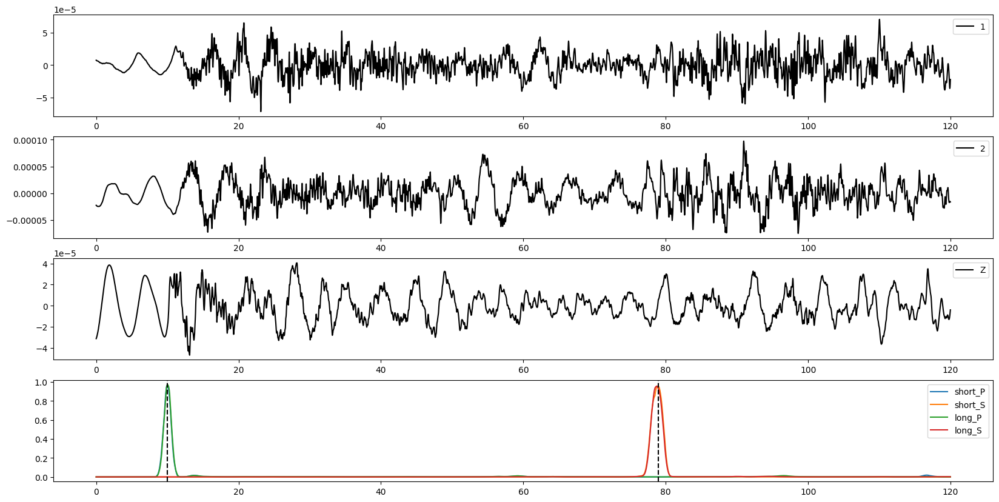

In [10]:
offset=int((UTCDateTime(timestamp[0])-UTCDateTime(timestamp[1]))*40)
true_p_offset=UTCDateTime("2010-02-07T23:24:16.949590")-UTCDateTime(timestamp[0])
true_s_offset=UTCDateTime("2010-02-07T23:25:25.888620")-UTCDateTime(timestamp[0])

fig,ax=plt.subplots(4,1,figsize=(20,10))

ax[0].plot(np.arange(4800)*0.025,vec_short[0,:4800],label="1",color="k")
ax[0].legend()
ax[1].plot(np.arange(4800)*0.025,vec_short[1,:4800],label="2",color="k")
ax[1].legend()
ax[2].plot(np.arange(4800)*0.025,vec_short[2,:4800],label="Z",color="k")
ax[2].legend()

ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][0]["P"][:4800],label="short_P")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][0]["S"][:4800],label="short_S")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][1]["P"][offset:offset+4800],label="long_P")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][1]["S"][offset:offset+4800],label="long_S")
# ax[3].plot(np.arange(4800)*0.025,prediction[0].data[offset:offset+4800],label="prediction_P")
# ax[3].plot(np.arange(4800)*0.025,prediction[1].data[offset:offset+4800],label="prediction_S")

# dash line for true arrival
ax[3].axvline(true_p_offset,color="k",linestyle="--")
ax[3].axvline(true_s_offset,color="k",linestyle="--") 

ax[3].legend()
plt.show()

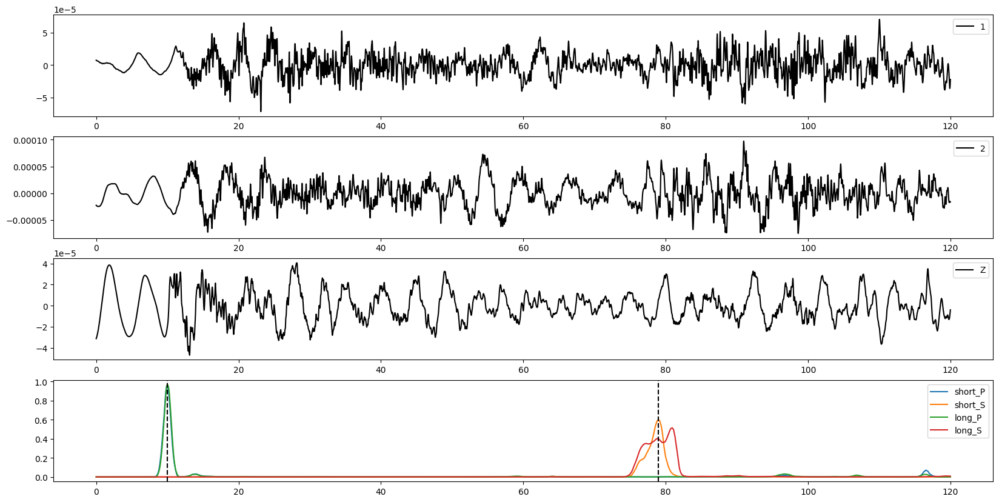

In [127]:
offset=int((UTCDateTime(timestamp[0])-UTCDateTime(timestamp[1]))*40)
true_p_offset=UTCDateTime("2010-02-07T23:24:16.949590")-UTCDateTime(timestamp[0])
true_s_offset=UTCDateTime("2010-02-07T23:25:25.888620")-UTCDateTime(timestamp[0])

fig,ax=plt.subplots(4,1,figsize=(20,10))

ax[0].plot(np.arange(4800)*0.025,vec_short[0,:4800],label="1",color="k")
ax[0].legend()
ax[1].plot(np.arange(4800)*0.025,vec_short[1,:4800],label="2",color="k")
ax[1].legend()
ax[2].plot(np.arange(4800)*0.025,vec_short[2,:4800],label="Z",color="k")
ax[2].legend()

ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][0]["P"][:4800],label="short_P")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][0]["S"][:4800],label="short_S")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][1]["P"][offset:offset+4800],label="long_P")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][1]["S"][offset:offset+4800],label="long_S")
# ax[3].plot(np.arange(4800)*0.025,prediction[0].data[offset:offset+4800],label="prediction_P")
# ax[3].plot(np.arange(4800)*0.025,prediction[1].data[offset:offset+4800],label="prediction_S")

# dash line for true arrival
ax[3].axvline(true_p_offset,color="k",linestyle="--")
ax[3].axvline(true_s_offset,color="k",linestyle="--") 

ax[3].legend()
plt.show()

second one

In [128]:
long=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/2long.mseed")
short=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/2short.mseed")
prediction=obspy.read("/Users/ziyixi/Library/CloudStorage/OneDrive-MichiganStateUniversity/Packages_Research/PhaseNet-TF/workplace/Z1.TNGA.2010-10-10T05:00:00.000000Z.2010-10-10T06:00:00.000000Z.prediction.mseed")

In [129]:
vec_long=np.zeros((3,144001))
for i in range(3):
    vec_long[i,:]=long[i].data[:144001]

vec_short=np.zeros((3,4801))
for i in range(3):
    vec_short[i,:]=short[i].data[:4801]

In [130]:
id=["short.TNGA","long.TNGA"]
timestamp=["2010-10-10T05:49:36.027200","2010-10-10T05"]
vec=[vec_short.tolist(),vec_long.tolist()]
extract_phases=["P","S"]
extract_phase_sensitivity=[0.5,0.5]

headers = {
    'Content-Type': 'application/json'
}

request_body={
    "id":id,
    "timestamp":timestamp,
    "vec":vec,
    "extract_phases":extract_phases,
    "extract_phase_sensitivity":extract_phase_sensitivity
}

In [131]:
url = "http://0.0.0.0:8080/predict"
response = httpx.post(url, headers=headers, json=request_body,timeout=600)

# Check if the request was successful (HTTP status code 200)
if response.status_code == 200:
    print("Request was successful!")
    print("Response:", response.json())
else:
    print("Request failed with status code:", response.status_code)

Request was successful!
Response: {'id': ['short.TNGA', 'long.TNGA'], 'possibility': [{'noise': [0.9999780654907227, 0.9999929666519165, 0.9999977350234985, 0.9999991655349731, 0.9999997615814209, 0.9999997615814209, 0.9999997615814209, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 0.9999998807907104, 0.9999996423721313, 0.9999996423721313, 0.9999996423721313, 0.9999995231628418, 0.9999994039535522, 0.9999994039535522, 0.9999992847442627, 0.9999990463256836, 0.999998927116394, 0.9999988079071045, 0.9999986886978149, 0.9999984502792358, 0.9999982118606567, 0.9999979734420776, 0.9999978542327881, 0.999997615814209, 0.9999973773956299, 0.9999972581863403, 0.9999970197677612, 0.9999967813491821, 0.999996542930603, 0.999996542930603, 0.9999964237213135, 0.9999961853027344, 0.9999960660934448, 0.999996066093444

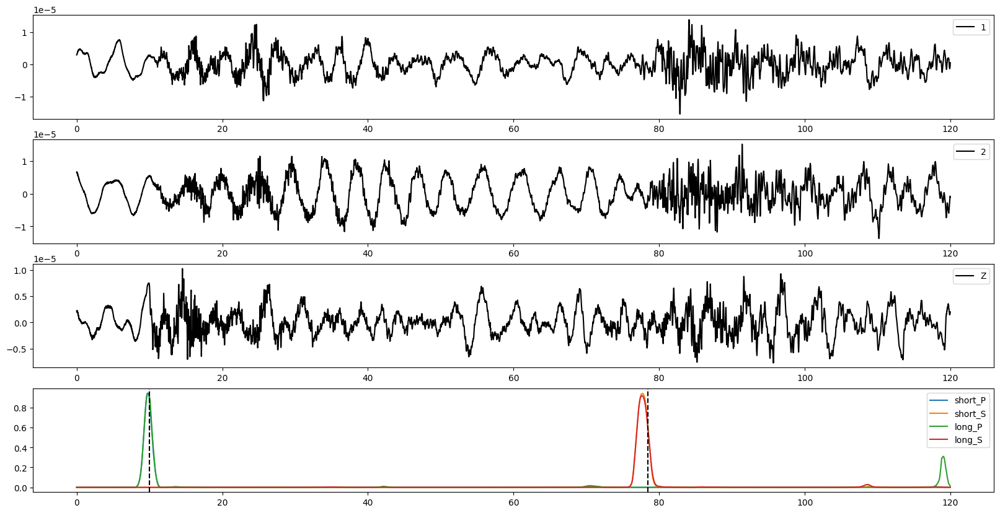

In [136]:
offset=int((UTCDateTime(timestamp[0])-UTCDateTime(timestamp[1]))*40)
true_p_offset=UTCDateTime("2010-10-10T05:49:46.027200")-UTCDateTime(timestamp[0])
true_s_offset=UTCDateTime("2010-10-10T05:50:54.471000")-UTCDateTime(timestamp[0])

fig,ax=plt.subplots(4,1,figsize=(20,10))

ax[0].plot(np.arange(4800)*0.025,vec_short[0,:4800],label="1",color="k")
ax[0].legend()
ax[1].plot(np.arange(4800)*0.025,vec_short[1,:4800],label="2",color="k")
ax[1].legend()
ax[2].plot(np.arange(4800)*0.025,vec_short[2,:4800],label="Z",color="k")
ax[2].legend()

ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][0]["P"][:4800],label="short_P")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][0]["S"][:4800],label="short_S")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][1]["P"][offset:offset+4800],label="long_P")
ax[3].plot(np.arange(4800)*0.025,response.json()["possibility"][1]["S"][offset:offset+4800],label="long_S")
# ax[3].plot(np.arange(4800)*0.025,prediction[0].data[offset:offset+4800],label="prediction_P")
# ax[3].plot(np.arange(4800)*0.025,prediction[1].data[offset:offset+4800],label="prediction_S")

# dash line for true arrival
ax[3].axvline(true_p_offset,color="k",linestyle="--")
ax[3].axvline(true_s_offset,color="k",linestyle="--") 

ax[3].legend()
plt.show()